<a href="https://colab.research.google.com/github/BoonthichaSaejia/2143488_Big-Data-and-Artificial-Intelligence/blob/master/2143488_W6_HW1_Code.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q kora

     |████████████████████████████████| 61kB 4.3MB/s 
     |████████████████████████████████| 61kB 4.2MB/s 


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from kora import data_table

In [ ]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import normalize
from sklearn.metrics import confusion_matrix
from sklearn.metrics import precision_score, recall_score, f1_score,accuracy_score

In [ ]:
from kora import eda

NumExpr defaulting to 2 threads.


## **1 Data Preparation and Data Cleaning**

In [ ]:
df=pd.read_csv('/content/drive/MyDrive/Data_for_MyColab/2143488_Big Data and Artificial Intelligence/HW3_movie_metadata.csv')
df.head(5)

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,movie_title,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,760505847.0,Action|Adventure|Fantasy|Sci-Fi,CCH Pounder,Avatar,886204,4834,Wes Studi,0.0,avatar|future|marine|native|paraplegic,http://www.imdb.com/title/tt0499549/?ref_=fn_t...,3054.0,English,USA,PG-13,237000000.0,2009.0,936.0,7.9,1.78,33000
1,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,309404152.0,Action|Adventure|Fantasy,Johnny Depp,Pirates of the Caribbean: At World's End,471220,48350,Jack Davenport,0.0,goddess|marriage ceremony|marriage proposal|pi...,http://www.imdb.com/title/tt0449088/?ref_=fn_t...,1238.0,English,USA,PG-13,300000000.0,2007.0,5000.0,7.1,2.35,0
2,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,200074175.0,Action|Adventure|Thriller,Christoph Waltz,Spectre,275868,11700,Stephanie Sigman,1.0,bomb|espionage|sequel|spy|terrorist,http://www.imdb.com/title/tt2379713/?ref_=fn_t...,994.0,English,UK,PG-13,245000000.0,2015.0,393.0,6.8,2.35,85000
3,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,448130642.0,Action|Thriller,Tom Hardy,The Dark Knight Rises,1144337,106759,Joseph Gordon-Levitt,0.0,deception|imprisonment|lawlessness|police offi...,http://www.imdb.com/title/tt1345836/?ref_=fn_t...,2701.0,English,USA,PG-13,250000000.0,2012.0,23000.0,8.5,2.35,164000
4,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,Doug Walker,Star Wars: Episode VII - The Force Awakens ...,8,143,NaN,0.0,NaN,http://www.imdb.com/title/tt5289954/?ref_=fn_t...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0


DataPrep Report
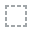
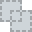
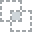
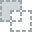
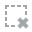
...
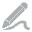
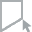
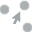
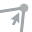
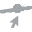

In [ ]:
eda.create_report(df)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 27 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   director_name              4939 non-null   object 
 1   num_critic_for_reviews     4993 non-null   float64
 2   duration                   5028 non-null   float64
 3   director_facebook_likes    4939 non-null   float64
 4   actor_3_facebook_likes     5020 non-null   float64
 5   actor_2_name               5030 non-null   object 
 6   actor_1_facebook_likes     5036 non-null   float64
 7   gross                      4159 non-null   float64
 8   genres                     5043 non-null   object 
 9   actor_1_name               5036 non-null   object 
 10  movie_title                5043 non-null   object 
 11  num_voted_users            5043 non-null   int64  
 12  cast_total_facebook_likes  5043 non-null   int64  
 13  actor_3_name               5020 non-null   objec

In [ ]:
col = df.columns
for i in col:
  if df[i].dtype!='O':
    arr = np.array(df[i])
    imp = SimpleImputer(missing_values=np.nan, strategy='mean')
    imp.fit(arr.reshape(-1, 1))
    SimpleImputer()
    df[i]=imp.transform(arr.reshape(-1, 1))
df

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,movie_title,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,James Cameron,723.000000,178.000000,0.000000,855.000000,Joel David Moore,1000.0,7.605058e+08,Action|Adventure|Fantasy|Sci-Fi,CCH Pounder,Avatar,886204.0,4834.0,Wes Studi,0.0,avatar|future|marine|native|paraplegic,http://www.imdb.com/title/tt0499549/?ref_=fn_t...,3054.000000,English,USA,PG-13,2.370000e+08,2009.000000,936.0,7.9,1.780000,33000.0
1,Gore Verbinski,302.000000,169.000000,563.000000,1000.000000,Orlando Bloom,40000.0,3.094042e+08,Action|Adventure|Fantasy,Johnny Depp,Pirates of the Caribbean: At World's End,471220.0,48350.0,Jack Davenport,0.0,goddess|marriage ceremony|marriage proposal|pi...,http://www.imdb.com/title/tt0449088/?ref_=fn_t...,1238.000000,English,USA,PG-13,3.000000e+08,2007.000000,5000.0,7.1,2.350000,0.0
2,Sam Mendes,602.000000,148.000000,0.000000,161.000000,Rory Kinnear,11000.0,2.000742e+08,Action|Adventure|Thriller,Christoph Waltz,Spectre,275868.0,11700.0,Stephanie Sigman,1.0,bomb|espionage|sequel|spy|terrorist,http://www.imdb.com/title/tt2379713/?ref_=fn_t...,994.000000,English,UK,PG-13,2.450000e+08,2015.000000,393.0,6.8,2.350000,85000.0
3,Christopher Nolan,813.000000,164.000000,22000.000000,23000.000000,Christian Bale,27000.0,4.481306e+08,Action|Thriller,Tom Hardy,The Dark Knight Rises,1144337.0,106759.0,Joseph Gordon-Levitt,0.0,deception|imprisonment|lawlessness|police offi...,http://www.imdb.com/title/tt1345836/?ref_=fn_t...,2701.000000,English,USA,PG-13,2.500000e+08,2012.000000,23000.0,8.5,2.350000,164000.0
4,Doug Walker,140.194272,107.201074,131.000000,645.009761,Rob Walker,131.0,4.846841e+07,Documentary,Doug Walker,Star Wars: Episode VII - The Force Awakens ...,8.0,143.0,NaN,0.0,NaN,http://www.imdb.com/title/tt5289954/?ref_=fn_t...,272.770808,NaN,NaN,NaN,3.975262e+07,2002.470517,12.0,7.1,2.220403,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1.000000,87.000000,2.000000,318.000000,Daphne Zuniga,637.0,4.846841e+07,Comedy|Drama,Eric Mabius,Signed Sealed Delivered,629.0,2283.0,Crystal Lowe,2.0,fraud|postal worker|prison|theft|trial,http://www.imdb.com/title/tt3000844/?ref_=fn_t...,6.000000,English,Canada,NaN,3.975262e+07,2013.000000,470.0,7.7,2.220403,84.0
5039,NaN,43.000000,43.000000,686.509212,319.000000,Valorie Curry,841.0,4.846841e+07,Crime|Drama|Mystery|Thriller,Natalie Zea,The Following,73839.0,1753.0,Sam Underwood,1.0,cult|fbi|hideout|prison escape|serial killer,http://www.imdb.com/title/tt2071645/?ref_=fn_t...,359.000000,English,USA,TV-14,3.975262e+07,2002.470517,593.0,7.5,16.000000,32000.0
5040,Benjamin Roberds,13.000000,76.000000,0.000000,0.000000,Maxwell Moody,0.0,4.846841e+07,Drama|Horror|Thriller,Eva Boehnke,A Plague So Pleasant,38.0,0.0,David Chandler,0.0,NaN,http://www.imdb.com/title/tt2107644/?ref_=fn_t...,3.000000,English,USA,NaN,1.400000e+03,2013.000000,0.0,6.3,2.220403,16.0
5041,Daniel Hsia,14.000000,100.000000,0.000000,489.000000,Daniel Henney,946.0,1.044300e+04,Comedy|Drama|Romance,Alan Ruck,Shanghai Calling,1255.0,2386.0,Eliza Coupe,5.0,NaN,http://www.imdb.com/title/tt2070597/?ref_=fn_t...,9.000000,English,USA,PG-13,3.975262e+07,2012.000000,719.0,6.3,2.350000,660.0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5043 entries, 0 to 5042
Data columns (total 27 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   director_name              4939 non-null   object 
 1   num_critic_for_reviews     5043 non-null   float64
 2   duration                   5043 non-null   float64
 3   director_facebook_likes    5043 non-null   float64
 4   actor_3_facebook_likes     5043 non-null   float64
 5   actor_2_name               5030 non-null   object 
 6   actor_1_facebook_likes     5043 non-null   float64
 7   gross                      5043 non-null   float64
 8   genres                     5043 non-null   object 
 9   actor_1_name               5036 non-null   object 
 10  movie_title                5043 non-null   object 
 11  num_voted_users            5043 non-null   float64
 12  cast_total_facebook_likes  5043 non-null   float64
 13  actor_3_name               5020 non-null   objec

In [ ]:
df_new = df.drop(['movie_imdb_link','movie_title','actor_1_name','actor_2_name','actor_3_name'],axis=1)
df_new['plot_keywords'] = df_new['plot_keywords'].replace(np.nan,'none')
for i in range(len(df_new)):
  if df_new.at[i,'genres']!=np.nan:
    df_new.at[i,'genres'] = df_new.at[i,'genres'].split('|')
  df_new.at[i,'plot_keywords'] = df_new.at[i,'plot_keywords'].split('|')
df_new

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,genres,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,plot_keywords,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,James Cameron,723.000000,178.000000,0.000000,855.000000,1000.0,7.605058e+08,"[Action, Adventure, Fantasy, Sci-Fi]",886204.0,4834.0,0.0,"[avatar, future, marine, native, paraplegic]",3054.000000,English,USA,PG-13,2.370000e+08,2009.000000,936.0,7.9,1.780000,33000.0
1,Gore Verbinski,302.000000,169.000000,563.000000,1000.000000,40000.0,3.094042e+08,"[Action, Adventure, Fantasy]",471220.0,48350.0,0.0,"[goddess, marriage ceremony, marriage proposal...",1238.000000,English,USA,PG-13,3.000000e+08,2007.000000,5000.0,7.1,2.350000,0.0
2,Sam Mendes,602.000000,148.000000,0.000000,161.000000,11000.0,2.000742e+08,"[Action, Adventure, Thriller]",275868.0,11700.0,1.0,"[bomb, espionage, sequel, spy, terrorist]",994.000000,English,UK,PG-13,2.450000e+08,2015.000000,393.0,6.8,2.350000,85000.0
3,Christopher Nolan,813.000000,164.000000,22000.000000,23000.000000,27000.0,4.481306e+08,"[Action, Thriller]",1144337.0,106759.0,0.0,"[deception, imprisonment, lawlessness, police ...",2701.000000,English,USA,PG-13,2.500000e+08,2012.000000,23000.0,8.5,2.350000,164000.0
4,Doug Walker,140.194272,107.201074,131.000000,645.009761,131.0,4.846841e+07,[Documentary],8.0,143.0,0.0,[none],272.770808,NaN,NaN,NaN,3.975262e+07,2002.470517,12.0,7.1,2.220403,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1.000000,87.000000,2.000000,318.000000,637.0,4.846841e+07,"[Comedy, Drama]",629.0,2283.0,2.0,"[fraud, postal worker, prison, theft, trial]",6.000000,English,Canada,NaN,3.975262e+07,2013.000000,470.0,7.7,2.220403,84.0
5039,NaN,43.000000,43.000000,686.509212,319.000000,841.0,4.846841e+07,"[Crime, Drama, Mystery, Thriller]",73839.0,1753.0,1.0,"[cult, fbi, hideout, prison escape, serial kil...",359.000000,English,USA,TV-14,3.975262e+07,2002.470517,593.0,7.5,16.000000,32000.0
5040,Benjamin Roberds,13.000000,76.000000,0.000000,0.000000,0.0,4.846841e+07,"[Drama, Horror, Thriller]",38.0,0.0,0.0,[none],3.000000,English,USA,NaN,1.400000e+03,2013.000000,0.0,6.3,2.220403,16.0
5041,Daniel Hsia,14.000000,100.000000,0.000000,489.000000,946.0,1.044300e+04,"[Comedy, Drama, Romance]",1255.0,2386.0,5.0,[none],9.000000,English,USA,PG-13,3.975262e+07,2012.000000,719.0,6.3,2.350000,660.0


In [ ]:
df_new = df_new.replace(np.nan,'Unknown')
df_new

,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,genres,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,plot_keywords,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes
0,James Cameron,723.000000,178.000000,0.000000,855.000000,1000.0,7.605058e+08,"[Action, Adventure, Fantasy, Sci-Fi]",886204.0,4834.0,0.0,"[avatar, future, marine, native, paraplegic]",3054.000000,English,USA,PG-13,2.370000e+08,2009.000000,936.0,7.9,1.780000,33000.0
1,Gore Verbinski,302.000000,169.000000,563.000000,1000.000000,40000.0,3.094042e+08,"[Action, Adventure, Fantasy]",471220.0,48350.0,0.0,"[goddess, marriage ceremony, marriage proposal...",1238.000000,English,USA,PG-13,3.000000e+08,2007.000000,5000.0,7.1,2.350000,0.0
2,Sam Mendes,602.000000,148.000000,0.000000,161.000000,11000.0,2.000742e+08,"[Action, Adventure, Thriller]",275868.0,11700.0,1.0,"[bomb, espionage, sequel, spy, terrorist]",994.000000,English,UK,PG-13,2.450000e+08,2015.000000,393.0,6.8,2.350000,85000.0
3,Christopher Nolan,813.000000,164.000000,22000.000000,23000.000000,27000.0,4.481306e+08,"[Action, Thriller]",1144337.0,106759.0,0.0,"[deception, imprisonment, lawlessness, police ...",2701.000000,English,USA,PG-13,2.500000e+08,2012.000000,23000.0,8.5,2.350000,164000.0
4,Doug Walker,140.194272,107.201074,131.000000,645.009761,131.0,4.846841e+07,[Documentary],8.0,143.0,0.0,[none],272.770808,Unknown,Unknown,Unknown,3.975262e+07,2002.470517,12.0,7.1,2.220403,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,Scott Smith,1.000000,87.000000,2.000000,318.000000,637.0,4.846841e+07,"[Comedy, Drama]",629.0,2283.0,2.0,"[fraud, postal worker, prison, theft, trial]",6.000000,English,Canada,Unknown,3.975262e+07,2013.000000,470.0,7.7,2.220403,84.0
5039,Unknown,43.000000,43.000000,686.509212,319.000000,841.0,4.846841e+07,"[Crime, Drama, Mystery, Thriller]",73839.0,1753.0,1.0,"[cult, fbi, hideout, prison escape, serial kil...",359.000000,English,USA,TV-14,3.975262e+07,2002.470517,593.0,7.5,16.000000,32000.0
5040,Benjamin Roberds,13.000000,76.000000,0.000000,0.000000,0.0,4.846841e+07,"[Drama, Horror, Thriller]",38.0,0.0,0.0,[none],3.000000,English,USA,Unknown,1.400000e+03,2013.000000,0.0,6.3,2.220403,16.0
5041,Daniel Hsia,14.000000,100.000000,0.000000,489.000000,946.0,1.044300e+04,"[Comedy, Drama, Romance]",1255.0,2386.0,5.0,[none],9.000000,English,USA,PG-13,3.975262e+07,2012.000000,719.0,6.3,2.350000,660.0


In [ ]:
from sklearn.preprocessing import MultiLabelBinarizer

In [ ]:
mlb = MultiLabelBinarizer()
df_genres=pd.DataFrame(mlb.fit_transform(df_new['genres']),columns='Genres_'+mlb.classes_, index=df_new.index)
df_genres

,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,Genres_Western
0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0
1,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
3,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
4,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5039,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0
5040,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
5041,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [ ]:
df_new=df_new.join(df_genres)
df_new=df_new.drop(['genres','plot_keywords'],axis=1)
df_new=pd.get_dummies(df_new)
df_new

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,...,country_Peru,country_Philippines,country_Poland,country_Romania,country_Russia,country_Slovakia,country_Slovenia,country_South Africa,country_South Korea,country_Soviet Union,country_Spain,country_Sweden,country_Switzerland,country_Taiwan,country_Thailand,country_Turkey,country_UK,country_USA,country_United Arab Emirates,country_Unknown,country_West Germany,content_rating_Approved,content_rating_G,content_rating_GP,content_rating_M,content_rating_NC-17,content_rating_Not Rated,content_rating_PG,content_rating_PG-13,content_rating_Passed,content_rating_R,content_rating_TV-14,content_rating_TV-G,content_rating_TV-MA,content_rating_TV-PG,content_rating_TV-Y,content_rating_TV-Y7,content_rating_Unknown,content_rating_Unrated,content_rating_X
0,723.000000,178.000000,0.000000,855.000000,1000.0,7.605058e+08,886204.0,4834.0,0.0,3054.000000,2.370000e+08,2009.000000,936.0,7.9,1.780000,33000.0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
1,302.000000,169.000000,563.000000,1000.000000,40000.0,3.094042e+08,471220.0,48350.0,0.0,1238.000000,3.000000e+08,2007.000000,5000.0,7.1,2.350000,0.0,1,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
2,602.000000,148.000000,0.000000,161.000000,11000.0,2.000742e+08,275868.0,11700.0,1.0,994.000000,2.450000e+08,2015.000000,393.0,6.8,2.350000,85000.0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
3,813.000000,164.000000,22000.000000,23000.000000,27000.0,4.481306e+08,1144337.0,106759.0,0.0,2701.000000,2.500000e+08,2012.000000,23000.0,8.5,2.350000,164000.0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0
4,140.194272,107.201074,131.000000,645.009761,131.0,4.846841e+07,8.0,143.0,0.0,272.770808,3.975262e+07,2002.470517,12.0,7.1,2.220403,0.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5038,1.000000,87.000000,2.000000,318.000000,637.0,4.846841e+07,629.0,2283.0,2.0,6.000000,3.975262e+07,2013.000000,470.0,7.7,2.220403,84.0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
5039,43.000000,43.000000,686.509212,319.000000,841.0,4.846841e+07,73839.0,1753.0,1.0,359.000000,3.975262e+07,2002.470517,593.0,7.5,16.000000,32000.0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
5040,13.000000,76.000000,0.000000,0.000000,0.0,4.846841e+07,38.0,0.0,0.0,3.000000,1.400000e+03,2013.000000,0.0,6.3,2.220403,16.0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
5041,14.000000,100.000000,0.000000,489.000000,946.0,1.044300e+04,

## **2 Data Visualization and Analysis**

In [ ]:
x = df_new.drop('imdb_score',axis=1)
y = df_new['imdb_score']

In [ ]:
for i in x.columns:
  x_array = np.array(x[i])
  normalized_arr = normalize([x_array])
  x[i]=normalized_arr[0]
x

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,aspect_ratio,movie_facebook_likes,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,...,country_Peru,country_Philippines,country_Poland,country_Romania,country_Russia,country_Slovakia,country_Slovenia,country_South Africa,country_South Korea,country_Soviet Union,country_Spain,country_Sweden,country_Switzerland,country_Taiwan,country_Thailand,country_Turkey,country_UK,country_USA,country_United Arab Emirates,country_Unknown,country_West Germany,content_rating_Approved,content_rating_G,content_rating_GP,content_rating_M,content_rating_NC-17,content_rating_Not Rated,content_rating_PG,content_rating_PG-13,content_rating_Passed,content_rating_R,content_rating_TV-14,content_rating_TV-G,content_rating_TV-MA,content_rating_TV-PG,content_rating_TV-Y,content_rating_TV-Y7,content_rating_Unknown,content_rating_Unrated,content_rating_X
0,0.054979,0.022763,0.000000,0.006757,0.000860,0.135868,7.713441e-02,0.003306,0.000000,0.092394,1.670553e-02,0.014127,0.003022,0.009667,0.022414,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.040291,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
1,0.022965,0.021612,0.002765,0.007903,0.034388,0.055277,4.101457e-02,0.033068,0.000000,0.037454,2.114625e-02,0.014113,0.016143,0.012763,0.000000,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
2,0.045778,0.018927,0.000000,0.001272,0.009457,0.035744,2.401131e-02,0.008002,0.005786,0.030072,1.726943e-02,0.014170,0.001269,0.012763,0.057732,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.047246,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
3,0.061823,0.020973,0.108046,0.181760,0.023212,0.080061,9.960208e-02,0.073015,0.000000,0.081714,1.762187e-02,0.014148,0.074256,0.012763,0.111389,0.02945,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
4,0.010661,0.013709,0.000643,0.005097,0.000113,0.008659,6.963129e-07,0.000098,0.000000,0.008252,2.802062e-03,0.014081,0.000039,0.012059,0.000000,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.090909,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.447214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.057448,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,

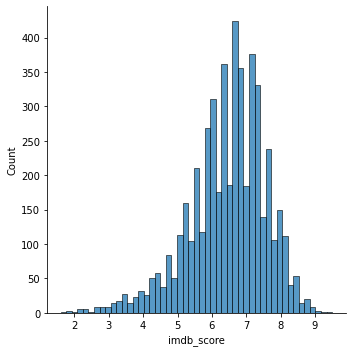

In [ ]:
sns.displot(y)

In [ ]:
# because 6.6 is the median of imdb_score, we label the movie with imdb_score more than 6.6 that is good or 1
for i in range(len(y)):
  if y[i]>6.6:
    y[i]=1
  else:
    y[i]=0

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


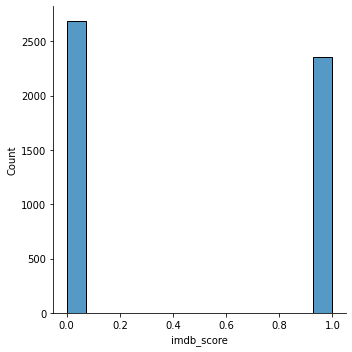

In [ ]:
sns.displot(y)

In [ ]:
x.columns[:15]

Index(['num_critic_for_reviews', 'duration', 'director_facebook_likes',
       'actor_3_facebook_likes', 'actor_1_facebook_likes', 'gross',
       'num_voted_users', 'cast_total_facebook_likes', 'facenumber_in_poster',
       'num_user_for_reviews', 'budget', 'title_year',
       'actor_2_facebook_likes', 'aspect_ratio', 'movie_facebook_likes'],
      dtype='object')

In [ ]:
x[x.columns[:15]].corr()

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,num_voted_users,cast_total_facebook_likes,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,aspect_ratio,movie_facebook_likes
num_critic_for_reviews,1.000000,0.255242,0.178907,0.270935,0.189727,0.441966,0.623805,0.262899,-0.033633,0.608509,0.115756,0.272200,0.281758,-0.047702,0.682669
duration,0.255242,1.000000,0.153708,0.123012,0.088377,0.204975,0.314597,0.123033,0.013361,0.326152,0.064412,-0.119520,0.131229,-0.085871,0.196565
director_facebook_likes,0.178907,0.153708,1.000000,0.120120,0.090555,0.139229,0.296271,0.119307,-0.040822,0.221167,0.020907,-0.063819,0.119482,0.000057,0.161420
actor_3_facebook_likes,0.270935,0.123012,0.120120,1.000000,0.249855,0.304314,0.287041,0.473629,0.099277,0.229994,0.047095,0.095710,0.559570,-0.003345,0.278753
actor_1_facebook_likes,0.189727,0.088377,0.090555,0.249855,1.000000,0.140581,0.192755,0.951472,0.072227,0.145372,0.022324,0.086679,0.390443,-0.018664,0.135336
gross,0.441966,0.204975,0.139229,0.304314,0.140581,1.000000,0.615385,0.229040,-0.025511,0.538448,0.101437,0.022622,0.258099,0.014829,0.369427
num_voted_users,0.623805,0.314597,0.296271,0.287041,0.192755,0.615385,1.000000,0.265911,-0.026946,0.797797,0.078495,0.007377,0.270675,-0.014582,0.537924
cast_total_facebook_likes,0.262899,0.123033,0.119307,0.473629,0.951472,0.229040,0.265911,1.000000,0.091455,0.206828,0.036028,0.109737,0.628173,-0.016932,0.209786
facenumber_in_poster,-0.033633,0.013361,-0.040822,0.099277,0.072227,-0.025511,-0.026946,0.091455,1.000000,-0.068836,-0.018712,0.060769,0.071184,0.013050,0.008856
num_user_for_reviews,0.608509,0.326152,0.221167,0.229994,0.145372,0.538448,0.797797,0.206828,-0.068836,1.000000,0.082879,-0.003157,0.219346,-0.024328,0.400469


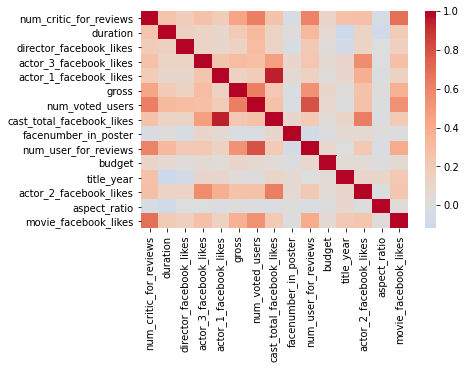

In [ ]:
sns.heatmap(x[x.columns[:15]].corr(),center=0,cmap='coolwarm')

In [ ]:
x=x.drop(['cast_total_facebook_likes','num_voted_users','movie_facebook_likes'],axis=1)
x

,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_1_facebook_likes,gross,facenumber_in_poster,num_user_for_reviews,budget,title_year,actor_2_facebook_likes,aspect_ratio,Genres_Action,Genres_Adventure,Genres_Animation,Genres_Biography,Genres_Comedy,Genres_Crime,Genres_Documentary,Genres_Drama,Genres_Family,Genres_Fantasy,Genres_Film-Noir,Genres_Game-Show,Genres_History,Genres_Horror,Genres_Music,Genres_Musical,Genres_Mystery,Genres_News,Genres_Reality-TV,Genres_Romance,Genres_Sci-Fi,Genres_Short,Genres_Sport,Genres_Thriller,Genres_War,Genres_Western,director_name_A. Raven Cruz,director_name_Aaron Hann,...,country_Peru,country_Philippines,country_Poland,country_Romania,country_Russia,country_Slovakia,country_Slovenia,country_South Africa,country_South Korea,country_Soviet Union,country_Spain,country_Sweden,country_Switzerland,country_Taiwan,country_Thailand,country_Turkey,country_UK,country_USA,country_United Arab Emirates,country_Unknown,country_West Germany,content_rating_Approved,content_rating_G,content_rating_GP,content_rating_M,content_rating_NC-17,content_rating_Not Rated,content_rating_PG,content_rating_PG-13,content_rating_Passed,content_rating_R,content_rating_TV-14,content_rating_TV-G,content_rating_TV-MA,content_rating_TV-PG,content_rating_TV-Y,content_rating_TV-Y7,content_rating_Unknown,content_rating_Unrated,content_rating_X
0,0.054979,0.022763,0.000000,0.006757,0.000860,0.135868,0.000000,0.092394,1.670553e-02,0.014127,0.003022,0.009667,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.040291,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
1,0.022965,0.021612,0.002765,0.007903,0.034388,0.055277,0.000000,0.037454,2.114625e-02,0.014113,0.016143,0.012763,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.040489,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
2,0.045778,0.018927,0.000000,0.001272,0.009457,0.035744,0.005786,0.030072,1.726943e-02,0.014170,0.001269,0.012763,0.02945,0.032915,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.047246,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
3,0.061823,0.020973,0.108046,0.181760,0.023212,0.080061,0.000000,0.081714,1.762187e-02,0.014148,0.074256,0.012763,0.02945,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.026622,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.016207,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.026162,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0
4,0.010661,0.013709,0.000643,0.005097,0.000113,0.008659,0.000000,0.008252,2.802062e-03,0.014081,0.000039,0.012059,0.00000,0.000000,0.0,0.0,0.000000,0.000000,0.090909,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.447214,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.057448,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

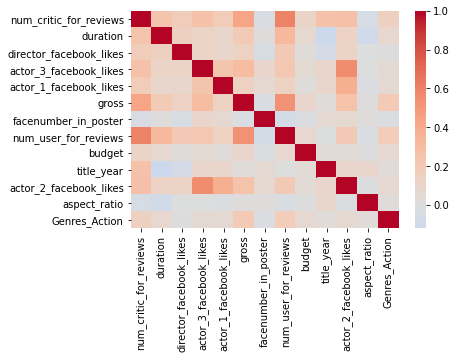

In [ ]:
sns.heatmap(x[x.columns[:13]].corr(),center=0,cmap='coolwarm')

## **3 Decision Tree**

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
y = np.array(y).astype('int').reshape(-1, 1)

In [ ]:
x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.3,random_state=69)

In [ ]:
print('x_train:',x_train.shape)
print('y_train:',y_train.shape)
print('x_test:', x_test.shape)
print('y_test:', y_test.shape)

x_train: (3530, 2570)
y_train: (3530, 1)
x_test: (1513, 2570)
y_test: (1513, 1)


In [ ]:
from sklearn.tree import DecisionTreeClassifier

In [ ]:
dtree = DecisionTreeClassifier()
dtree.fit(x_train, y_train)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')


## **4 Testing and Evaluation**

In [ ]:
confusion_matrix(y_test, dtree.predict(x_test))

array([[605, 221],
       [215, 472]])

In [ ]:
print("Accuracy: ", accuracy_score(y_test, dtree.predict(x_test)))
print("F1_Score: ", f1_score(y_test, dtree.predict(x_test)))
print("Precision: ",precision_score(y_test, dtree.predict(x_test)))
print("Recall: ",   recall_score(y_test, dtree.predict(x_test)))

Accuracy:  0.7118307997356246
F1_Score:  0.6840579710144927
Precision:  0.6810966810966811
Recall:  0.6870451237263464


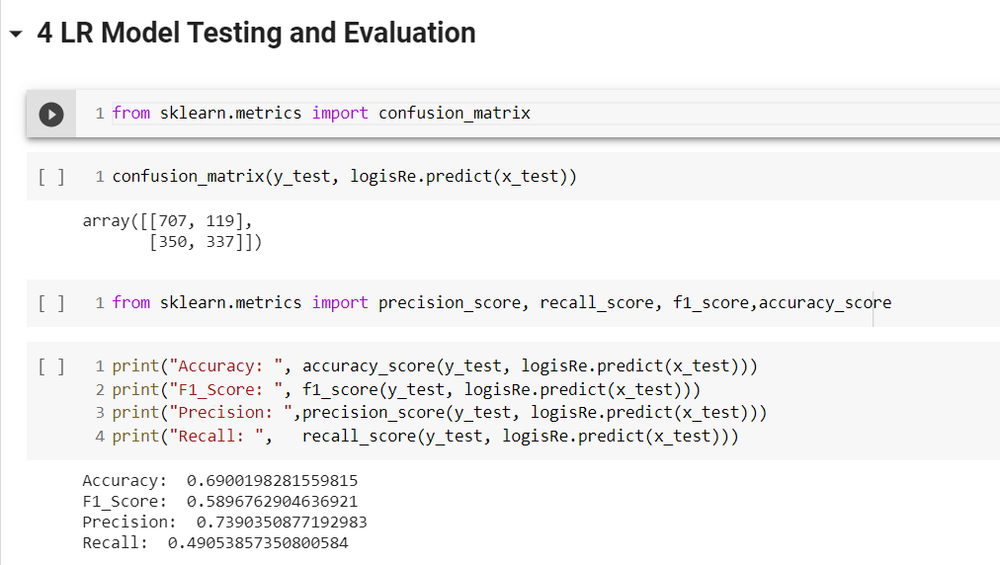

comparing to Logistic Regression, Decision Tree Classifier without tuning is better in every score besides precision score